In [10]:
import librosa
import numpy as np
import pywt
import os
import matplotlib.pyplot as plt
%matplotlib inline

In [11]:
filename='CV Project 10/ICBHI\Healthy/102_1b1_Ar_sc_Meditron_1.wav'


In [12]:

# Load the audio file with the original sample rate
data, sample_rate = librosa.load(filename, sr=None)

# Target sample rate
new_sample_rate = 44100

# Resample the data to the new sample rate
resampled_data = librosa.resample(data, orig_sr=sample_rate, target_sr=new_sample_rate)

# Applying Discrete Wavelet Transform (DWT)
coeffs = pywt.wavedec(resampled_data, wavelet='haar', level=5)


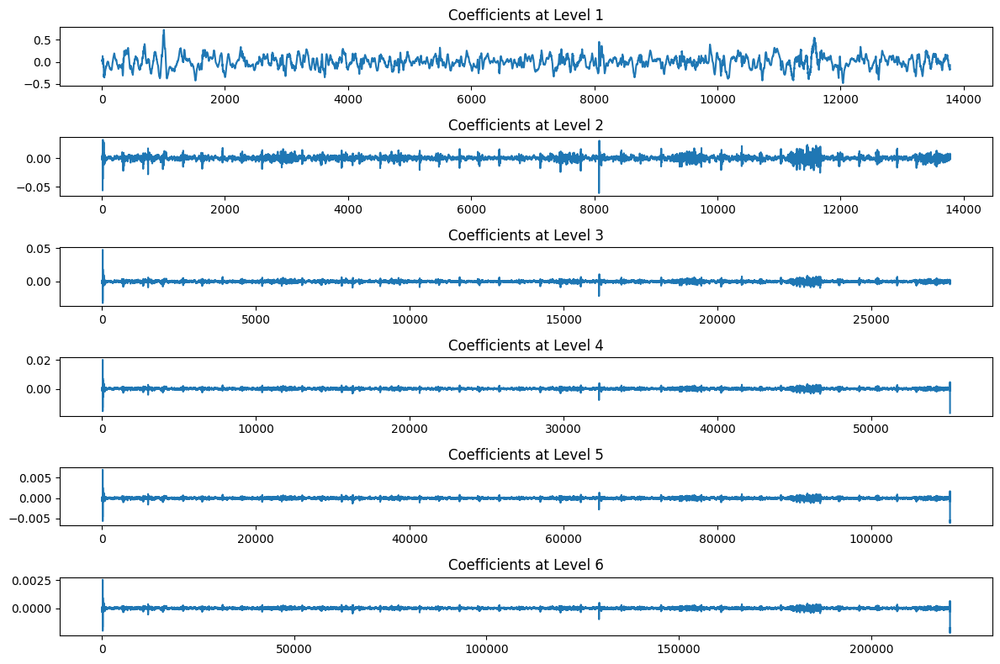

In [13]:
import matplotlib.pyplot as plt

# Assuming you have already computed 'coeffs' using the code snippet you provided

# Plot the DWT coefficients
plt.figure(figsize=(12, 8))
for i, coeff in enumerate(coeffs, 1):
    plt.subplot(len(coeffs), 1, i)
    plt.plot(coeff)
    plt.title(f'Coefficients at Level {i}')
plt.tight_layout()
plt.show()

In [14]:
import numpy as np
import os
import pywt
import librosa

def apply_dwt_to_file(file_path, target_sr=44100):
    data, sample_rate = librosa.load(file_path, sr=None)
    resampled_data = librosa.resample(data, orig_sr=sample_rate, target_sr=target_sr)
    coeffs = pywt.wavedec(resampled_data, wavelet='haar', level=5)
    return coeffs

def get_label(directory_path):
    if "Healthy" in directory_path:
        return 0  # Healthy
    elif "COPD" in directory_path:
        return 1  # COPD
    elif "Pneumonia" in directory_path:
        return 2  # Pneumonia
    else:
        return -1  # Unknown/Other

def process_directory_with_labels(directory_path, target_sr=44100, fixed_length=100):
    data = []
    labels = []
    for root, dirs, files in os.walk(directory_path):
        for file in files:
            if file.endswith(".wav"):
                file_path = os.path.join(root, file)
                coeffs = apply_dwt_to_file(file_path, target_sr)
                # Consider only the last coefficient array
                last_coeff = coeffs[-1]
                # Pad or truncate the last coefficient array to the fixed length
                if len(last_coeff) < fixed_length:
                    padded_last_coeff = np.pad(last_coeff, (0, fixed_length - len(last_coeff)), 'constant')
                else:
                    padded_last_coeff = last_coeff[:fixed_length]
                data.append(padded_last_coeff)
                label = get_label(root)
                labels.append(label)
    return np.array(data), np.array(labels)

# Assuming your base directory structure is 'CV Project 10/ICBHI' and contains 'Healthy', 'COPD', and 'Pneumonia' subdirectories
base_directory = 'CV Project 10/ICBHI'
data, labels = process_directory_with_labels(base_directory)

print("Data shape:", data.shape)
print("Labels shape:", labels.shape)


Data shape: (236, 100)
Labels shape: (236,)


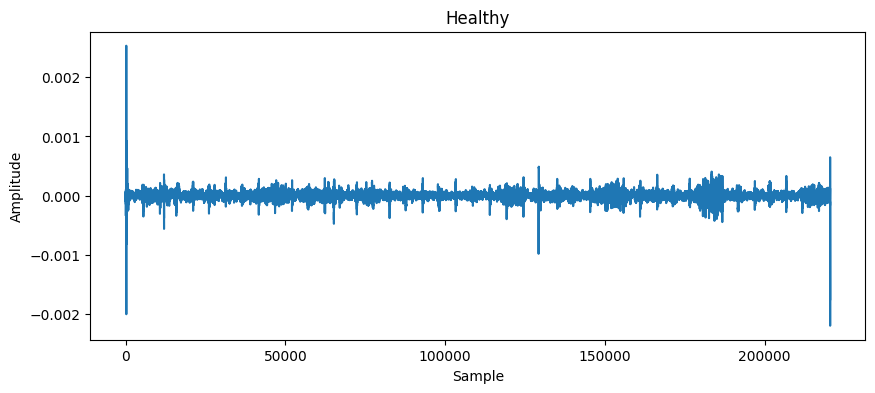

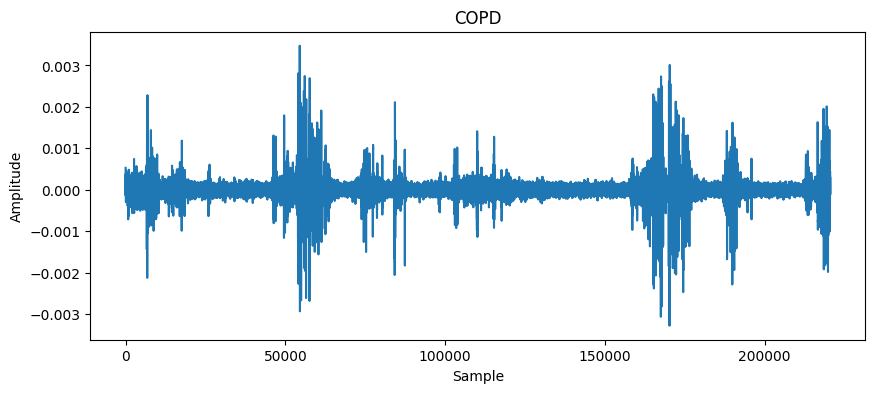

In [15]:
import matplotlib.pyplot as plt

# Function to load, resample, apply DWT, and extract the last coefficient
def process_and_plot_example(file_path):
    data, sample_rate = librosa.load(file_path, sr=None)
    resampled_data = librosa.resample(data, orig_sr=sample_rate, target_sr=44100)
    coeffs = pywt.wavedec(resampled_data, wavelet='haar', level=5)
    last_coeff = coeffs[-1]

    plt.figure(figsize=(10, 4))
    plt.plot(last_coeff)
    plt.title(f'{file_path.split("/")[-2]}')
    plt.xlabel('Sample')
    plt.ylabel('Amplitude')
    plt.show()

# Example file paths (adjust these paths based on your actual file structure)
healthy_example = 'CV Project 10/ICBHI/Healthy/102_1b1_Ar_sc_Meditron_1.wav'
copd_example = 'CV Project 10/ICBHI/COPD/106_2b1_Pl_mc_LittC2SE_1.wav'
pneumonia_example = 'CV Project 10/ICBHI/Pneumonia/some_example.wav'  # Adjust this path

# Process and plot each example
process_and_plot_example(healthy_example)
process_and_plot_example(copd_example)
# process_and_plot_example(pneumonia_example) # Uncomment when a real path is provided


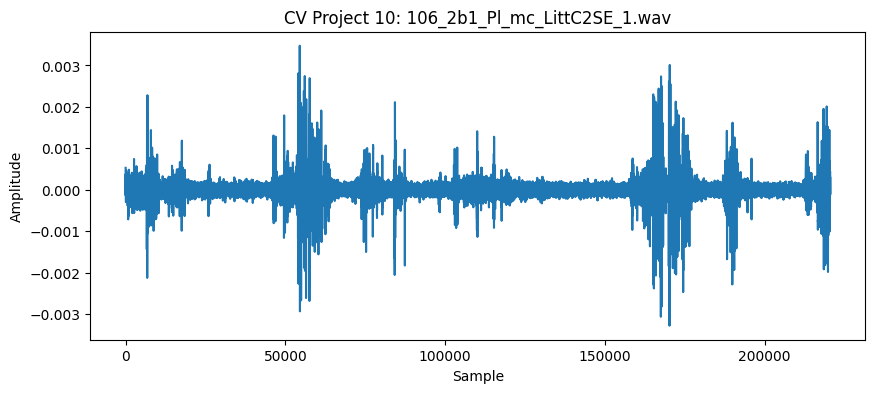

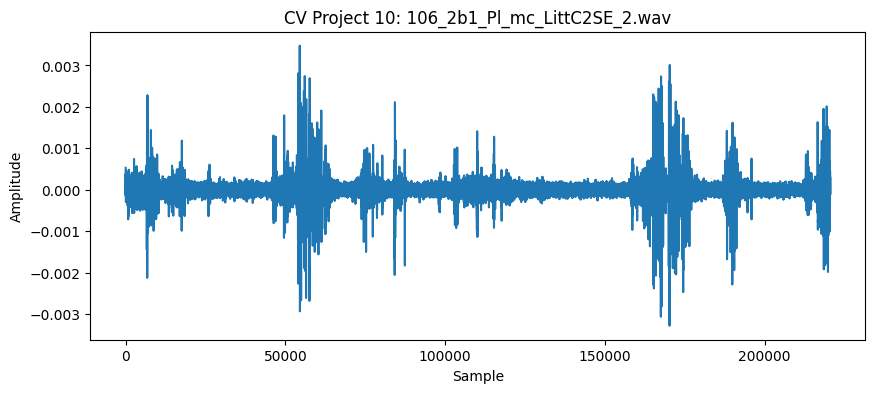

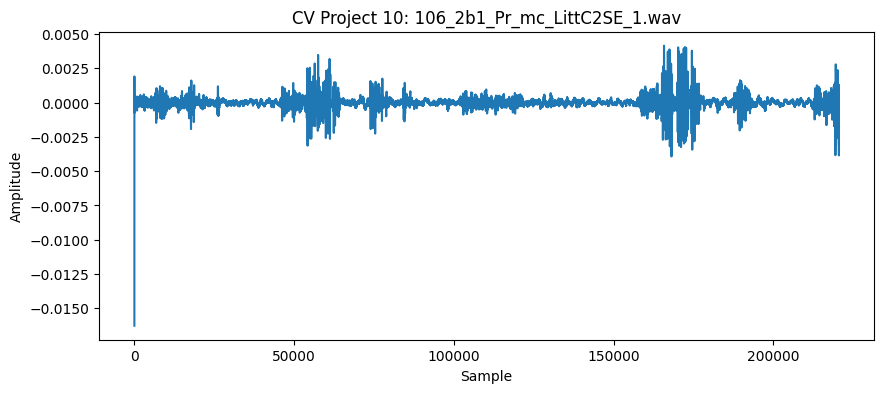

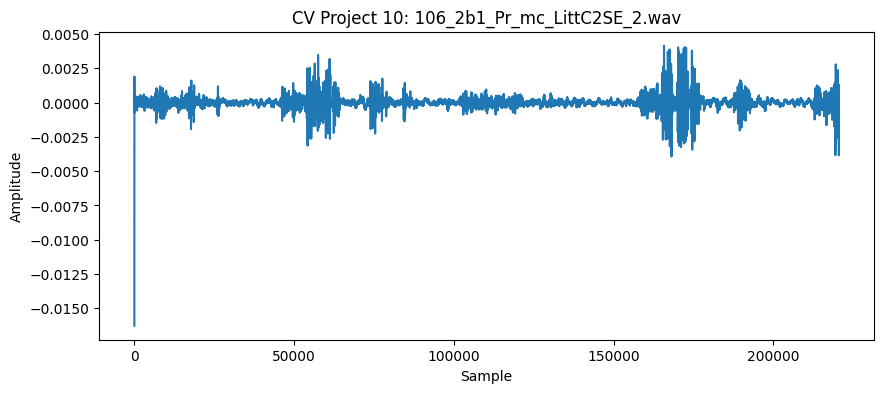

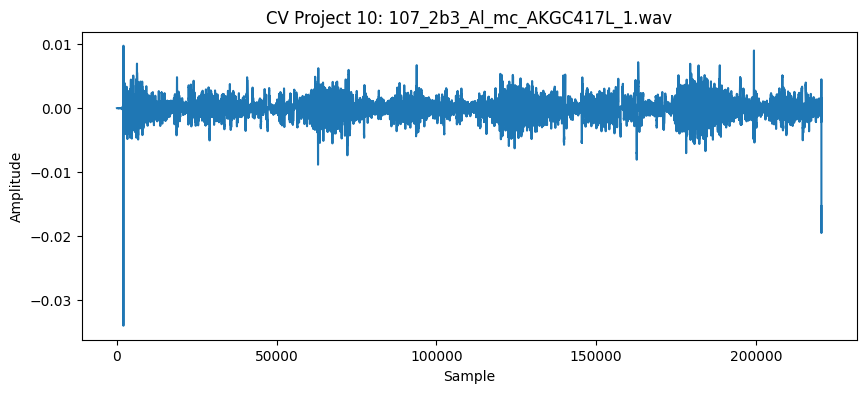

...

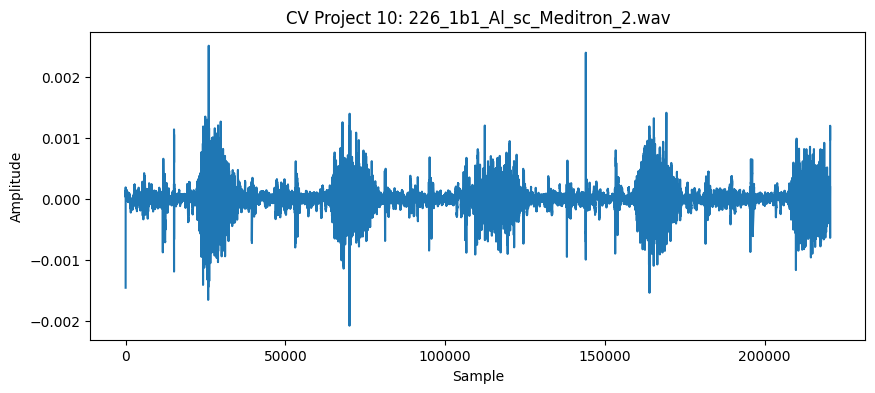

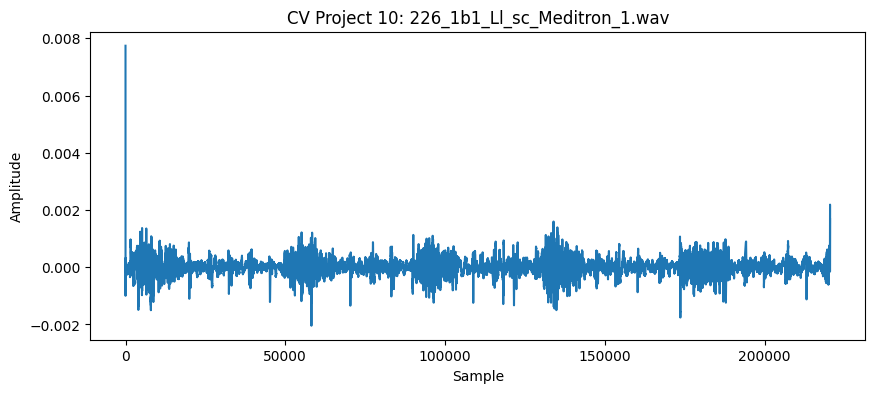

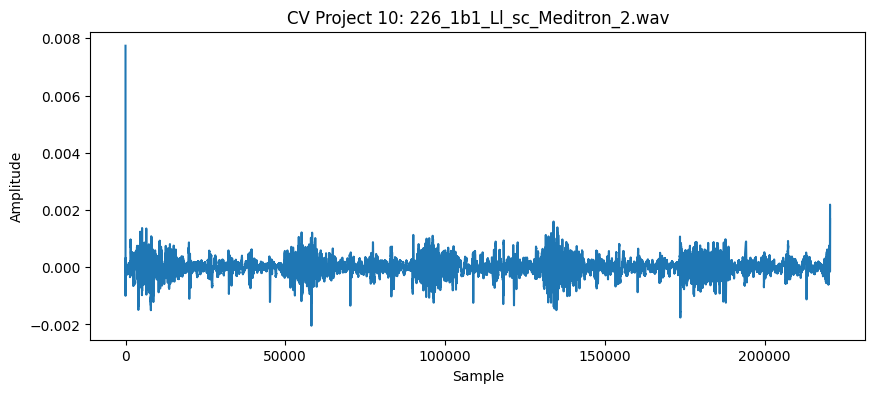

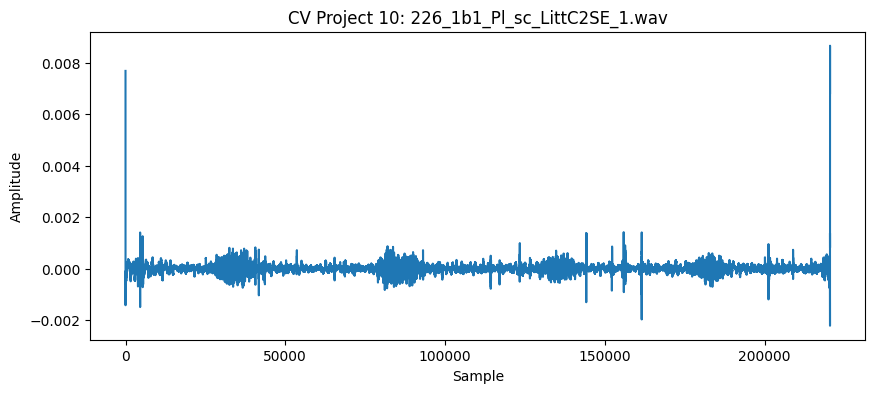

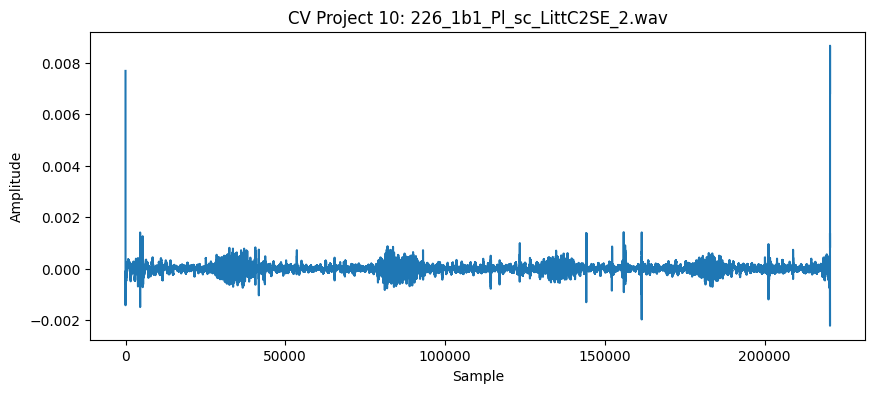

In [16]:
import os

# Adjusted function to process a file and return the last coefficient and label
def process_file_and_get_label(file_path):
    data, sample_rate = librosa.load(file_path, sr=None)
    resampled_data = librosa.resample(data, orig_sr=sample_rate, target_sr=44100)
    coeffs = pywt.wavedec(resampled_data, wavelet='haar', level=5)
    last_coeff = coeffs[-1]
    # Infer label from the file path
    label = file_path.split("/")[-2]  # Adjust this based on your OS and file path structure
    return last_coeff, label

# Function to process all files in a given directory and its subdirectories
def process_directory(base_directory):
    for root, dirs, files in os.walk(base_directory):
        for file in files:
            if file.endswith(".wav"):
                file_path = os.path.join(root, file)
                last_coeff, label = process_file_and_get_label(file_path)
                
                # Plotting the last coefficient array for the file
                plt.figure(figsize=(10, 4))
                plt.plot(last_coeff)
                plt.title(f'{label}: {file}')
                plt.xlabel('Sample')
                plt.ylabel('Amplitude')
                plt.show()

# Base directory path
base_directory = 'CV Project 10/ICBHI'
process_directory(base_directory)


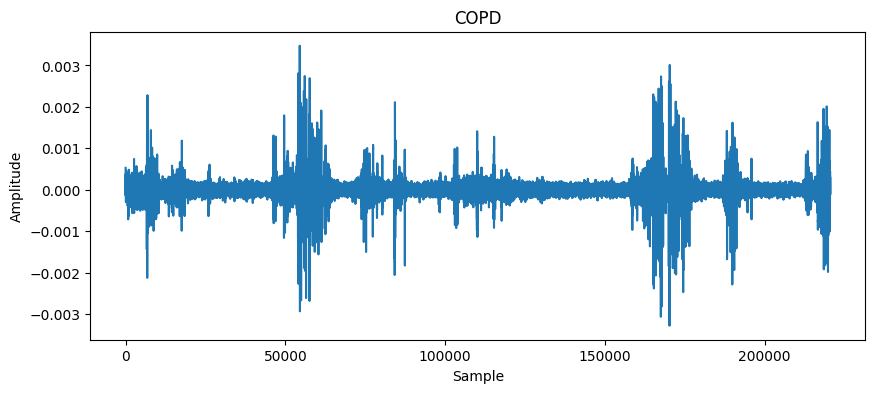

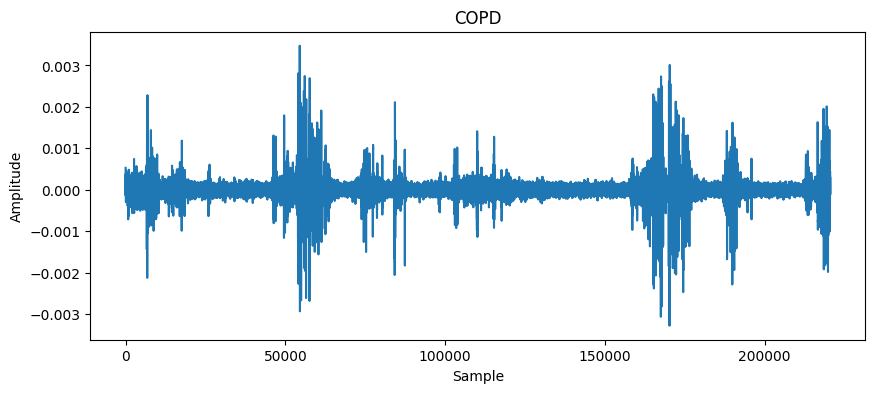

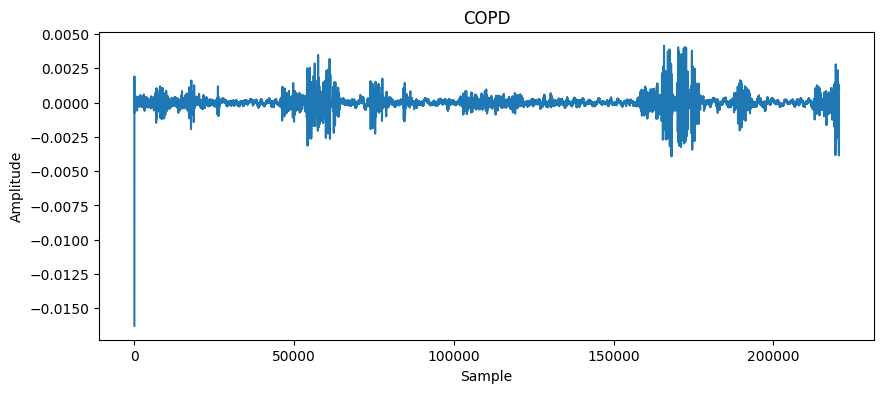

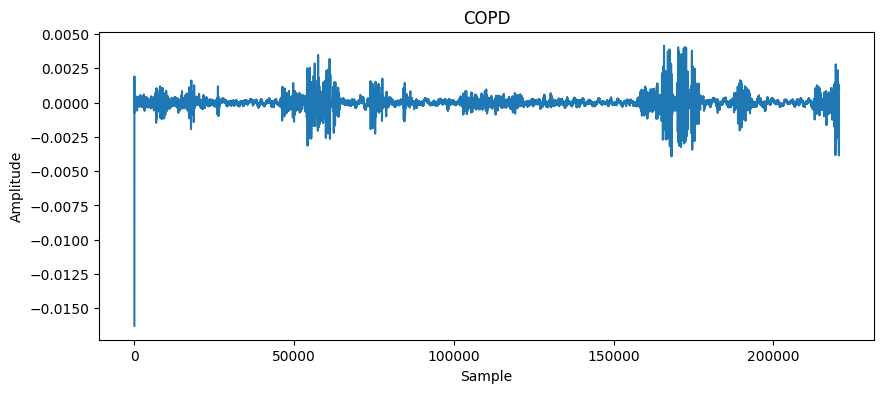

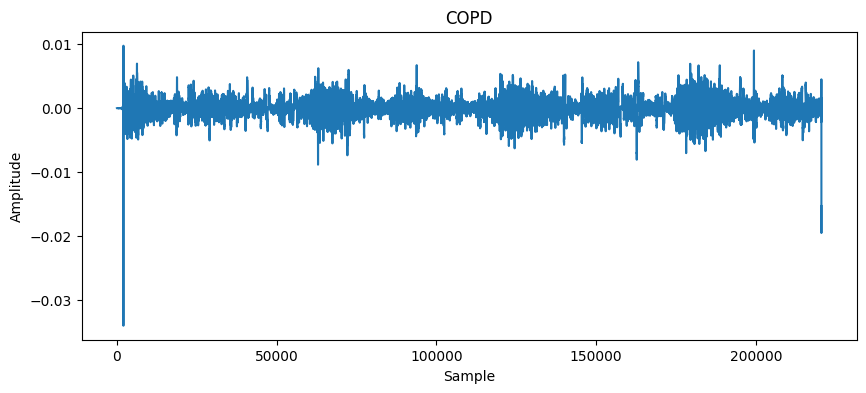

...

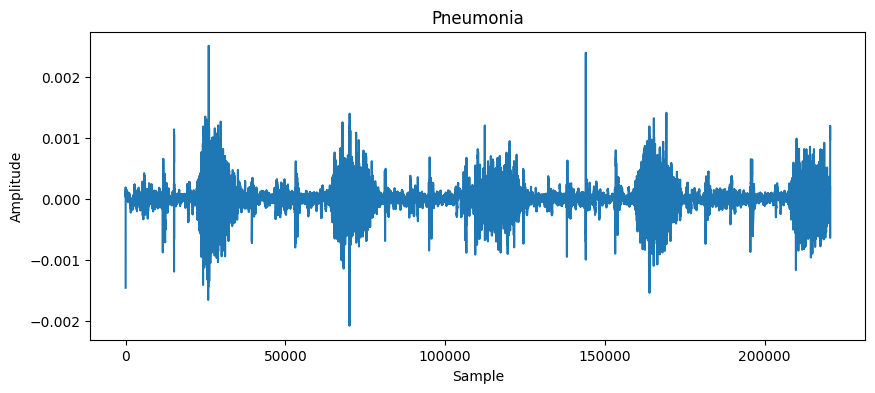

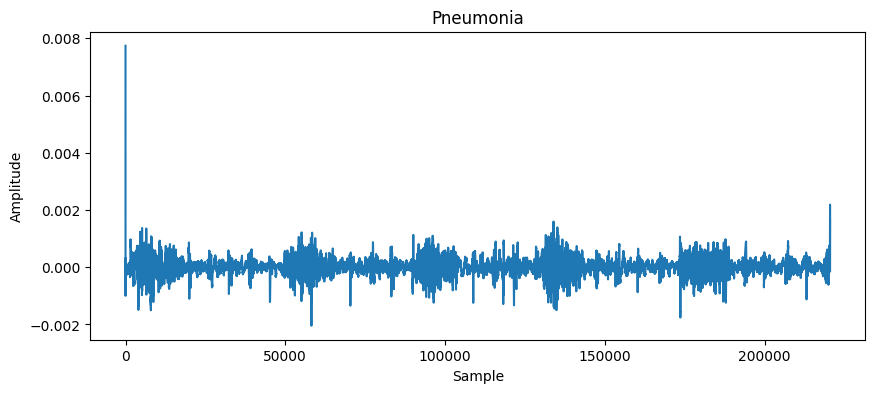

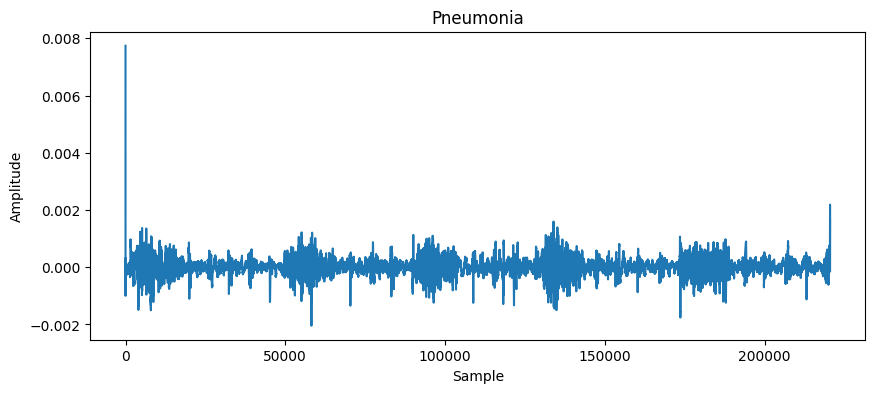

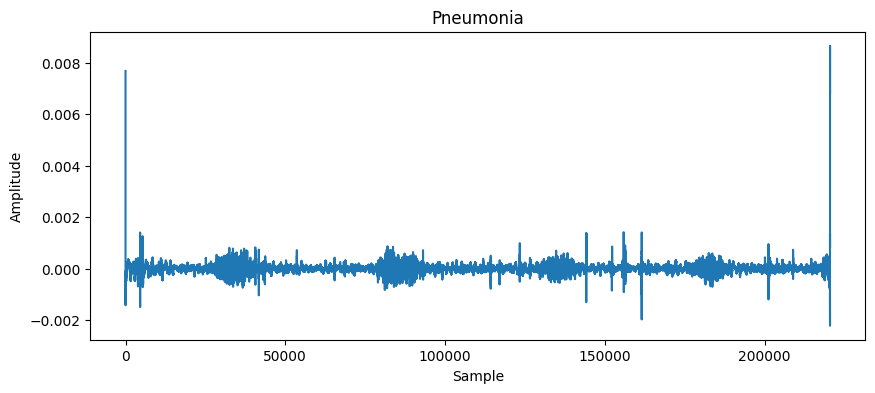

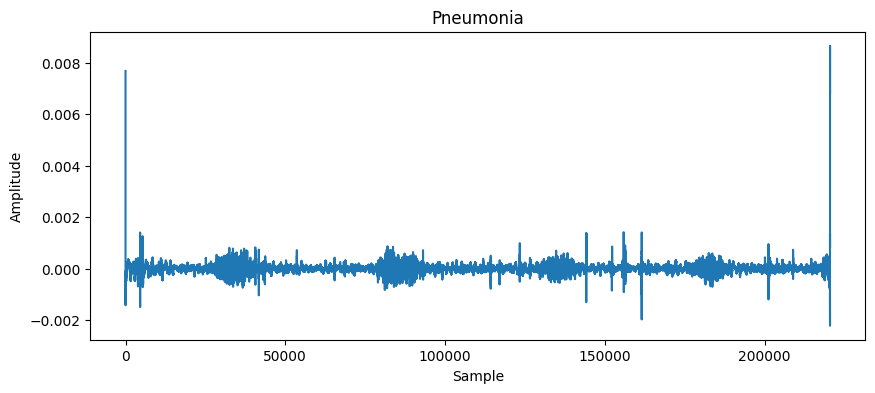

In [17]:
import os

# Function to determine the label based on the directory name in the file path
def determine_label_from_path(file_path):
    # Here, you check parts of the file path to determine the label
    if "Healthy" in file_path:
        return "Healthy"
    elif "COPD" in file_path:
        return "COPD"
    elif "Pneumonia" in file_path:
        return "Pneumonia"
    else:
        return "Unknown"  # For files that don't match the expected directories

# Adjusted function to process a file, plot, and return the processed data with a label
def process_file_plot_and_label(file_path):
    data, sample_rate = librosa.load(file_path, sr=None)
    resampled_data = librosa.resample(data, orig_sr=sample_rate, target_sr=44100)
    coeffs = pywt.wavedec(resampled_data, wavelet='haar', level=5)
    last_coeff = coeffs[-1]
    
    # Determine the label from the file path
    label = determine_label_from_path(file_path)

    # Plotting
    plt.figure(figsize=(10, 4))
    plt.plot(last_coeff)
    plt.title(label)
    plt.xlabel('Sample')
    plt.ylabel('Amplitude')
    plt.show()

    return last_coeff, label

# Function to process all files within specific directories
def process_directory_and_label(base_directory):
    for root, dirs, files in os.walk(base_directory):
        for file in files:
            if file.endswith(".wav"):
                file_path = os.path.join(root, file)
                process_file_plot_and_label(file_path)

# Base directory where your dataset is stored
base_directory = 'CV Project 10/ICBHI'
process_directory_and_label(base_directory)
